In [3]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import datetime
from tqdm import tqdm

# Gunnison

In [4]:
wd = "D:/Projects/Watersheds/Gunnison/Data"
os.chdir(wd)

In [5]:
df = pd.read_csv('dv', sep='\t', comment='#' , header=0)
df = df[df['agency_cd']=='USGS']
df = df.drop(['agency_cd', '17767_00060_00003_cd'], axis=1)
sites = df['site_no'].unique()

In [21]:
# Get monitoring wells only in study area
stf_df = pd.read_excel('gns_sel_stf_data.xlsx', dtype=str)
sites_lst = stf_df.SITENO.tolist()

In [22]:
type(sites_lst[0])

str

In [23]:
dff = pd.DataFrame()
dff['date'] = pd.date_range('1/1/1980', '12/31/2020')
dff = dff.set_index('date')

for i in tqdm(sites_lst):
    data = df[df['site_no']==str(i)]
    data.index = data.datetime
    # current data index is not datetimeindex so you need to convert it
    data.index = pd.to_datetime(data.index)
    data = data[~data.index.duplicated(keep='first')]
    data = data.drop(['site_no', 'datetime'], axis=1)
    data = data.rename({'17767_00060_00003': i}, axis=1)
    data = data.replace({i:['Ice','Ssn', 'Dis']}, np.nan)
    # convert cfs to cms
    data[i] = data[i].astype('float')*0.0283
    dff = pd.concat([dff, data], axis=1, sort=True)
dff.index.name = 'date'
dff = dff.astype('float')
# dff.dtypes
print('done')

100%|██████████| 41/41 [00:02<00:00, 19.86it/s]done



In [24]:
dff

,09107000,09107500,09109000,09110000,09111250,09111500,09112200,09112500,09113100,09113500,...,09136100,09136200,09137050,09143000,09143500,09144200,09144250,09149500,383103106594200,385106106571000
date,,,,,,,,,,,,,,,,,,,,,
1980-01-01,NaN,NaN,3.73560,5.3770,NaN,NaN,1.7546,1.6131,NaN,0.39620,...,NaN,50.374,0.13584,0.10188,0.10471,0.7358,57.7320,4.75440,NaN,NaN
1980-01-02,NaN,NaN,3.73560,5.3770,NaN,NaN,1.7546,1.8678,NaN,0.39620,...,NaN,51.506,0.13301,0.10754,0.11037,0.7358,58.2980,4.75440,NaN,NaN
1980-01-03,NaN,NaN,3.73560,5.0940,NaN,NaN,1.7546,1.9244,NaN,0.42450,...,NaN,50.940,0.13584,0.10188,0.10188,0.7358,58.2980,4.69780,NaN,NaN
1980-01-04,NaN,NaN,3.73560,5.0940,NaN,NaN,1.7546,1.9810,NaN,0.45280,...,NaN,50.940,0.13584,0.09622,0.10188,0.7358,58.2980,4.61290,NaN,NaN
1980-01-05,NaN,NaN,3.73560,5.0940,NaN,NaN,1.7829,1.9244,NaN,0.42450,...,NaN,50.374,0.13584,0.09622,0.10188,0.7075,58.0150,4.47140,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-04-22,1.80271,NaN,2.50172,3.5941,NaN,NaN,4.3582,4.7261,NaN,1.68102,...,2.41399,NaN,NaN,0.39620,0.62260,NaN,21.1401,1.63008,8.5749,2.68567
2021-04-23,1.83667,NaN,2.50172,3.6790,0.40752,NaN,4.3016,4.6978,NaN,1.78290,...,2.42248,NaN,NaN,0.37073,0.55751,NaN,20.9986,1.63574,8.7447,2.56115
2021-04-24,1.78856,NaN,2.50172,3.5375,0.42167,NaN,3.9054,4.2167,NaN,1.57914,...,1.95270,NaN,NaN,0.46695,0.65373,NaN,20.4326,1.68951,8.3202,2.28664


In [13]:
min_number_of_data = 365
dff = dff.loc[:, (dff.notnull().sum(axis=0) >= min_number_of_data)]

In [14]:
dff

,09107000,09107500,09109000,09110000,09110990,09111250,09111500,09112200,09112500,09113100,...,09136100,09136200,09137050,09143000,09143500,09144200,09144250,09149500,383103106594200,385106106571000
date,,,,,,,,,,,,,,,,,,,,,
1980-01-01,NaN,NaN,3.73560,5.3770,NaN,NaN,NaN,1.7546,1.6131,NaN,...,NaN,50.374,0.13584,0.10188,0.10471,0.7358,57.7320,4.75440,NaN,NaN
1980-01-02,NaN,NaN,3.73560,5.3770,NaN,NaN,NaN,1.7546,1.8678,NaN,...,NaN,51.506,0.13301,0.10754,0.11037,0.7358,58.2980,4.75440,NaN,NaN
1980-01-03,NaN,NaN,3.73560,5.0940,NaN,NaN,NaN,1.7546,1.9244,NaN,...,NaN,50.940,0.13584,0.10188,0.10188,0.7358,58.2980,4.69780,NaN,NaN
1980-01-04,NaN,NaN,3.73560,5.0940,NaN,NaN,NaN,1.7546,1.9810,NaN,...,NaN,50.940,0.13584,0.09622,0.10188,0.7358,58.2980,4.61290,NaN,NaN
1980-01-05,NaN,NaN,3.73560,5.0940,NaN,NaN,NaN,1.7829,1.9244,NaN,...,NaN,50.374,0.13584,0.09622,0.10188,0.7075,58.0150,4.47140,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-04-22,1.80271,NaN,2.50172,3.5941,NaN,NaN,NaN,4.3582,4.7261,NaN,...,2.41399,NaN,NaN,0.39620,0.62260,NaN,21.1401,1.63008,8.5749,2.68567
2021-04-23,1.83667,NaN,2.50172,3.6790,NaN,0.40752,NaN,4.3016,4.6978,NaN,...,2.42248,NaN,NaN,0.37073,0.55751,NaN,20.9986,1.63574,8.7447,2.56115
2021-04-24,1.78856,NaN,2.50172,3.5375,NaN,0.42167,NaN,3.9054,4.2167,NaN,...,1.95270,NaN,NaN,0.46695,0.65373,NaN,20.4326,1.68951,8.3202,2.28664


In [15]:
dff.count()

09107000           12262
09107500            1827
09109000           15092
09110000           15092
09110990             687
09111250            1404
09111500            4760
09112200           10709
09112500           14989
09113100            2190
09113500            1122
09113980            8180
09114500           15082
09114520             612
09115500           10435
09118450           14395
09119000           15054
09123400            1825
09123450            3092
09124010             560
09124500           15084
09126000           15069
09127000            3687
09128000           15091
09128500            5386
09129600            3886
09131100            1003
09132050             638
09132095            1706
09132500           15092
09132940            2475
09132960            4475
09132985            2497
09132995            4570
09134000           10319
09134100            4940
09135900            6118
09135950            2172
09136100            4393
09136200            2099


<AxesSubplot:xlabel='date'>

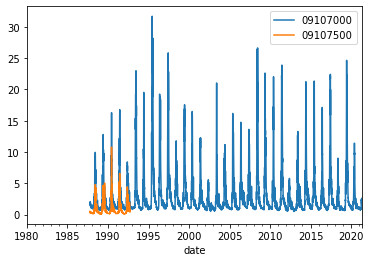

In [40]:
dff.iloc[:, [0, 1]].plot()

In [16]:
dff.to_csv('testout.txt', sep='\t', na_rep='-999', float_format='%.2f')

In [17]:
meaure_nums = dff.count()

In [18]:
type(meaure_nums)

pandas.core.series.Series

In [19]:
meaure_nums.to_excel('testout.xlsx', na_rep='-999')

In [20]:
meaure_nums.index

Index(['09107000', '09107500', '09109000', '09110000', '09110990', '09111250',
       '09111500', '09112200', '09112500', '09113100', '09113500', '09113980',
       '09114500', '09114520', '09115500', '09118450', '09119000', '09123400',
       '09123450', '09124010', '09124500', '09126000', '09127000', '09128000',
       '09128500', '09129600', '09131100', '09132050', '09132095', '09132500',
       '09132940', '09132960', '09132985', '09132995', '09134000', '09134100',
       '09135900', '09135950', '09136100', '09136200', '09137050', '09143000',
       '09143500', '09144200', '09144250', '09149500', '383103106594200',
       '385106106571000'],
      dtype='object')

# Get only what we use

In [35]:
# Get monitoring wells only in study area
stf_df = pd.read_excel('gns_sel_stf_data2.xlsx', dtype=str)
sites_lst = stf_df.SITENO.tolist()
sub_lst = stf_df.sub_id.tolist()

['70',
 '74',
 '82',
 '1082',
 '50',
 '55',
 '84',
 '108',
 '88',
 '102',
 '114',
 '123',
 '124',
 '179',
 '193',
 '133',
 '219',
 '209',
 '196',
 '141',
 '119',
 '89',
 '92',
 '15',
 '21',
 '4',
 '12',
 '41',
 '36',
 '52',
 '61',
 '67',
 '58',
 '45',
 '3',
 '11',
 '42',
 '64',
 '642',
 '127',
 '63']

In [41]:
dff = pd.DataFrame()
dff['date'] = pd.date_range('1/1/1980', '12/31/2020')
dff = dff.set_index('date')

for i, j in tqdm(zip(sites_lst, sub_lst)):
    data = df[df['site_no']==str(i)]
    data.index = data.datetime
    # current data index is not datetimeindex so you need to convert it
    data.index = pd.to_datetime(data.index)
    data = data[~data.index.duplicated(keep='first')]
    data = data.drop(['site_no', 'datetime'], axis=1)
    new_colnam = 'sub{:04d}'.format(int(j))
    data = data.rename({'17767_00060_00003': new_colnam}, axis=1)
    data = data.replace({new_colnam:['Ice','Ssn', 'Dis']}, np.nan)
    # convert cfs to cms
    data[new_colnam] = data[new_colnam].astype('float')*0.0283
    dff = pd.concat([dff, data], axis=1, sort=True)
dff.index.name = 'date'
dff = dff.astype('float')
# dff.dtypes
print('done')

41it [00:02, 19.82it/s]done



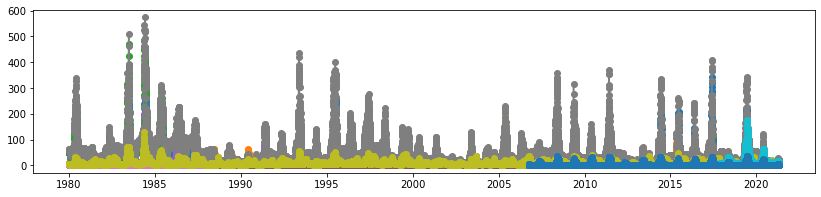

In [43]:
fig, ax = plt.subplots(figsize=(14, 3))
ax.plot(dff.index, dff, '-o')

plt.show()

In [42]:
dff

,sub0070,sub0074,sub0082,sub1082,sub0050,sub0055,sub0084,sub0108,sub0088,sub0102,...,sub0067,sub0058,sub0045,sub0003,sub0011,sub0042,sub0064,sub0642,sub0127,sub0063
date,,,,,,,,,,,,,,,,,,,,,
1980-01-01,NaN,NaN,3.73560,5.3770,NaN,NaN,1.7546,1.6131,NaN,0.39620,...,NaN,50.374,0.13584,0.10188,0.10471,0.7358,57.7320,4.75440,NaN,NaN
1980-01-02,NaN,NaN,3.73560,5.3770,NaN,NaN,1.7546,1.8678,NaN,0.39620,...,NaN,51.506,0.13301,0.10754,0.11037,0.7358,58.2980,4.75440,NaN,NaN
1980-01-03,NaN,NaN,3.73560,5.0940,NaN,NaN,1.7546,1.9244,NaN,0.42450,...,NaN,50.940,0.13584,0.10188,0.10188,0.7358,58.2980,4.69780,NaN,NaN
1980-01-04,NaN,NaN,3.73560,5.0940,NaN,NaN,1.7546,1.9810,NaN,0.45280,...,NaN,50.940,0.13584,0.09622,0.10188,0.7358,58.2980,4.61290,NaN,NaN
1980-01-05,NaN,NaN,3.73560,5.0940,NaN,NaN,1.7829,1.9244,NaN,0.42450,...,NaN,50.374,0.13584,0.09622,0.10188,0.7075,58.0150,4.47140,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-04-22,1.80271,NaN,2.50172,3.5941,NaN,NaN,4.3582,4.7261,NaN,1.68102,...,2.41399,NaN,NaN,0.39620,0.62260,NaN,21.1401,1.63008,8.5749,2.68567
2021-04-23,1.83667,NaN,2.50172,3.6790,0.40752,NaN,4.3016,4.6978,NaN,1.78290,...,2.42248,NaN,NaN,0.37073,0.55751,NaN,20.9986,1.63574,8.7447,2.56115
2021-04-24,1.78856,NaN,2.50172,3.5375,0.42167,NaN,3.9054,4.2167,NaN,1.57914,...,1.95270,NaN,NaN,0.46695,0.65373,NaN,20.4326,1.68951,8.3202,2.28664


In [45]:
mdff = dff.resample('M').mean()

No handles with labels found to put in legend.


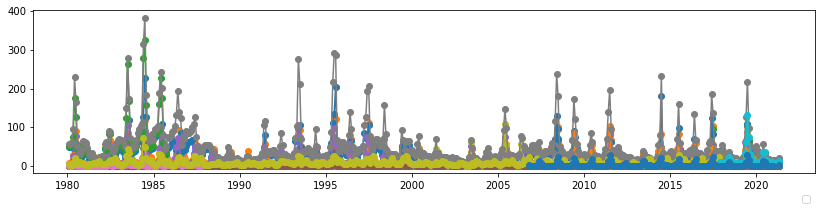

In [48]:
fig, ax = plt.subplots(figsize=(14, 3))
ax.plot(mdff.index, mdff, '-o')

plt.legend(bbox_to_anchor=(1,-0.1), ncol=5)
plt.show()

In [76]:
mdff[['sub0064', 'sub0119']].to_csv('stf_mon2.obd', sep='\t', na_rep='-999', float_format='%.2f')

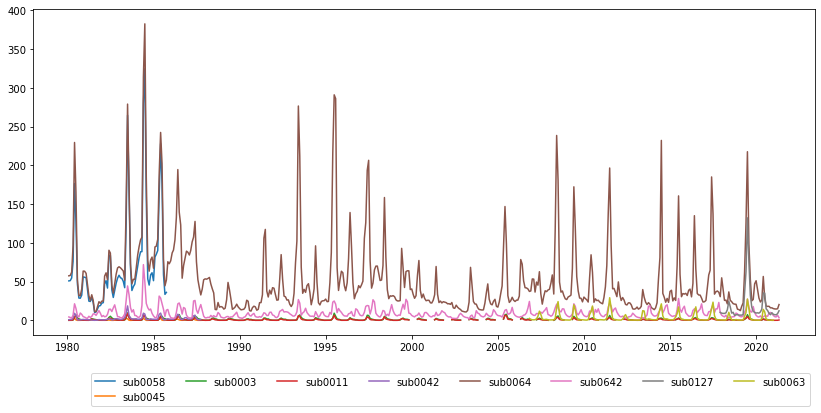

In [75]:
fig, ax = plt.subplots(figsize=(14, 6))
# for i in range(len(mdff.columns[8:16])):
for i in range(32,41):
    ax.plot(mdff.index, mdff.iloc[:, i], '-', label=mdff.columns[i])

# ax.text(
#         0.98, 0.9,
#         'Number of gage stations used: {}'.format(len(mdff.columns)),
#         horizontalalignment='right',fontsize=10,
#         bbox=dict(facecolor='green', alpha=0.5),
#         transform=ax.transAxes
#         ) 

plt.legend(bbox_to_anchor=(1,-0.1), ncol=8)
plt.show()